In [1]:
from pettingzoo.classic import connect_four_v3
import random
from IPython.display import clear_output
import matplotlib.pyplot as plt
import numpy as np
from collections import defaultdict
import plotting
from tqdm import tqdm

ModuleNotFoundError: No module named 'pettingzoo'

In [2]:
env = connect_four_v3.env(render_mode='rgb_array')


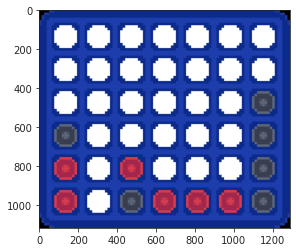

player_1
[0, 1, 2, 3, 4, 5, 6]


ValueError: invalid literal for int() with base 10: 'None'

In [21]:
env.reset()
for agent in env.agent_iter():
    print(agent)
    if agent == 'player_0':
        observation, reward, termination, truncation, info = env.last()
        if not termination and not truncation:
            action_mask = observation['action_mask']
            possible_action = list(np.where(action_mask ==1)[0])
            action = random.choice(possible_action)
            
        else: 
            action = None
    else:
        if not termination and not truncation:
            action = int(input("Enter your value: "))
        else:
            action = None
    env.step(action)
    clear_output(wait=True)
    plt.imshow(env.render())
    plt.show()




In [3]:
class QLearner(): 
    """
        Stores the data and computes the observed returns.
    """
    def __init__(self, 
                 action_space, 
                 observation_space, 
                 gamma=0.99, 
                 lr=0.5,
                 eps_init=.5, 
                 eps_min=1e-5,
                 eps_step=1-3,
                 name='Q-learning'):
        
        self.action_space = action_space
        self.observation_space = observation_space
        self.gamma = gamma
        self.lr = lr
        
        self.eps = eps_init
        self.eps_min = eps_min
        self.eps_step = eps_step

        self.name = name
        
        self.reset()
    
    def eps_greedy(self, obs, eps=None):
        if eps is None: 
            eps = self.eps
        action_mask = obs['action_mask']
        possible_action = list(np.where(action_mask ==1)[0])
        if np.random.random() < self.eps:
            try:
                action = random.choice(possible_action)
            except:
                action = None
            return action
        else:
            b = self.q_values[str(obs)]
            return np.random.choice(np.flatnonzero(b == np.max(b))) # argmax with random tie-breaking
            #return np.argmax(b)
        
    def get_action(self, obs): 
        return self.eps_greedy(obs)
        
    def update(self, obs, action, reward, terminated, next_obs):
        # update the q-values
        estimate_value_at_next_state = (not terminated) * np.max(self.q_values[str(next_obs)])
        new_estimate = reward + self.gamma * estimate_value_at_next_state
        
        self.q_values[str(obs)][action] = (
            (1 - self.lr) * self.q_values[str(obs)][action] 
            + self.lr * new_estimate
        )
        
        self.epsilon_decay()
        
    def epsilon_decay(self):
        self.eps = max(self.eps - self.eps_step, self.eps_min)
        
    def reset(self):
        print(self.action_space)
        self.q_values = defaultdict(lambda: np.zeros(len(self.action_space)))

In [139]:
def run_N_episodes(env, agent, N_episodes=1):
    for _ in tqdm(range(N_episodes)):
        done = False
        state = env.reset()
        while not done:
            action = agent.get_action(state)
            next_state, reward, terminated, truncated, info = env.last()
            agent.update(state, action, reward, terminated, next_state['observation'])
            done = terminated or truncated
            state = next_state
    return env, agent

In [8]:
env = connect_four_v3.env(render_mode='rgb_array')
lr = 0.1
gamma = 0.9999

N_episodes = 100
eps_init = .5
eps_step = 10 / N_episodes
possible_action = {0,1,2,3,4,5,6}

agent = QLearner(possible_action, env.observation_space, gamma=gamma, lr=lr)
env, agent = run_N_episodes(env, agent, N_episodes=N_episodes)

plotting.plot_RW([np.max(agent.q_values[obs]) for obs in range(7)])

{0, 1, 2, 3, 4, 5, 6}


TypeError: 'QLearner' object is not subscriptable

In [4]:
def run_episode(env, agents, display=False):
    observation, reward, termination, truncation, info = env.last()
    done = False
    while not done: 
        
        if termination or truncation:
            done = True
            #break
        
        # red play (player 0)
        observation, reward, termination, truncation, info = env.last()
        action = agents[0].get_action(observation)
        if not(termination or truncation):
            env.step(action)
        next_observation, reward, termination, truncation, info = env.last()
        reward = env.rewards['player_0']
        agents[0].update(observation, action, reward, termination, next_observation)
        observation = next_observation
        if display: 
            clear_output(wait=True)
            plt.imshow(env.render())
            plt.show()
            
        #black play (player 1)
        print(env.agent_selection)
        observation, reward, termination, truncation, info = env.last()
        action = agents[1].get_action(observation)
        if not(termination or truncation):
            env.step(action)
        next_observation, reward, termination, truncation, info = env.last()
        reward = env.rewards['player_1']
        agents[1].update(observation, action, reward, termination, next_observation)
        observation = next_observation

        if display: 
            clear_output(wait=True)
            plt.imshow(env.render())
            plt.show()
            
    return env, agents

In [5]:
def run_N_episodes(env, agents, N_episodes=1):
    for i in range(N_episodes):
        env.reset()
        env, agents = run_episode(env, agents, display=False)
        print(str(i/N_episodes*100)+" %")
    return env, agents

In [9]:
env = connect_four_v3.env(render_mode='rgb_array')
env.reset()
possible_action = {0,1,2,3,4,5,6}
agents = [QLearner(possible_action, env.observation_space, gamma=gamma, lr=lr),RandomAgent()]
run_N_episodes(env, agents, N_episodes=10)

{0, 1, 2, 3, 4, 5, 6}
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
0.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
10.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
20.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
30.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
40.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
50.0 %
player_1
player_1
player_1
player_1
player_1
player_0
player_0
60.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
70.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
playe

(<pettingzoo.utils.wrappers.order_enforcing.OrderEnforcingWrapper at 0x1b0063eaa90>,
  <__main__.RandomAgent at 0x1b0063ea340>])

In [6]:
class RandomAgent: 
    """
        An agent that only moves down or right, depending on its position on the grid
    """
    def _init_(self, action_space, observation_space):
        self.action_space = action_space
        self.observation_space = observation_space
        
    def get_action(self, obs):
        observation, reward, termination, truncation, info = env.last()
        possible_action = {0,1,2,3,4,5,6}
        action_mask = observation['action_mask']
        possible_action = list(np.where(action_mask ==1)[0])
        #action = random.randint(0,6)
        try:
            action = random.choice(possible_action)
        except:
            action = None
        return action
    
    def update(self, obs, action, reward, terminated, next_obs):
        pass

In [9]:
for i in range (10):
    env.reset()
    run_episode(env, [agents[0], RandomAgent()], True)
    print(reward)

KeyboardInterrupt: 

In [10]:
def test_agent(env, agents, N_episodes):
    res = {'player_0':0,'player_1':0,'equal':0}
    for i in range(N_episodes):
        env.reset()
        env, agents = run_episode(env, agents, display=False)
        #print(env.rewards)
        if env.rewards['player_0']==1:
            res['player_0'] += 1
        elif env.rewards['player_1']==1:
            res['player_1'] += 1
        else:
            res['equal'] += 1
        print(str(i/N_episodes*100)+" %")
    print(res)
    return env, agents

In [27]:
test_agent(env, [agents[0], RandomAgent()], 100)

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [79]:
env = connect_four_v3.env(render_mode='rgb_array')
env.reset()
train = [agents[0],RandomAgent()]
run_N_episodes(env, train, N_episodes=40000)

player_1
player_1
player_1
player_1
player_1
player_1
player_1
0.0 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
0.0025 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
0.005 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
0.0075 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
0.01 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
0.0125 %
player_1
player_1
player_1
player_0
player_0
0.015 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
0.017499999999999998 %
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_1
player_0
player_0
0.02 %
player_1
playe

(<pettingzoo.utils.wrappers.order_enforcing.OrderEnforcingWrapper at 0x2c50c91e0a0>,
  <__main__.RandomAgent at 0x2c50c91e760>])

In [12]:
print(len(agents[0].q_values))
#print(len(agents[1].q_values))


2137


In [81]:
for qval in agents[0].q_values:
    print(agents[0].q_values[qval])


[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0.  0.  0.  0.  0.  0.  0.1]
[0.  0.  0.  0.  0.1 0.  0. ]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0.   0.   0.   0.19 0.   0.   0.  ]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0.]
[0. 0.

KeyboardInterrupt: 

In [13]:
class YourAgent: 
    """
        An agent that only moves down or right, depending on its position on the grid
    """
    def _init_(self, action_space, observation_space):
        self.action_space = action_space
        self.observation_space = observation_space
        
    def get_action(self, obs):
        action = int(input("Enter your value: "))
        return action
    
    def update(self, obs, action, reward, terminated, next_obs):
        pass

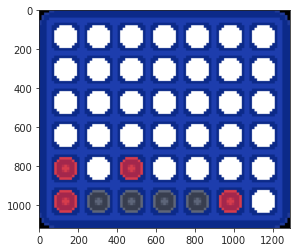

NameError: name 'reward' is not defined

In [14]:
env.reset()
run_episode(env, [agents[0], YourAgent()], True)
print(reward)

In [123]:
print(agents[0].q_values)

KeyboardInterrupt: 

In [16]:
import json
from json import JSONEncoder
import numpy

class NumpyArrayEncoder(JSONEncoder):
    def default(self, obj):
        if isinstance(obj, numpy.ndarray):
            return obj.tolist()
        return JSONEncoder.default(self, obj)

numpyArrayOne = agents[0].q_values

numpyData = {"arrayOne": numpyArrayOne,}
print("serialize NumPy array into JSON and write into a file")
with open("numpyData.json", "w") as write_file:
    json.dump(numpyData, write_file, cls=NumpyArrayEncoder)
print("Done writing serialized NumPy array into file")

serialize NumPy array into JSON and write into a file
Done writing serialized NumPy array into file


In [17]:
print("Started Reading JSON file")
with open("numpyData.json", "r") as read_file:
    print("Converting JSON encoded data into Numpy array")
    decodedArray = json.load(read_file)

    finalNumpyArrayOne = numpy.asarray(decodedArray["arrayOne"])
    print("NumPy Array One")
    print(finalNumpyArrayOne)
    

Started Reading JSON file
Converting JSON encoded data into Numpy array
NumPy Array One
{"{'observation': array([[[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 1]]], dtype=int8), 'action_mask': array([1, 1, 1, 1, 1, 1, 1], dtype=int8)}": [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], "{'observation': array([[[0, 0],\n        [0, 0],\n    

In [23]:
ag_tst = QLearner(possible_action, env.observation_space, gamma=gamma, lr=lr)

{0, 1, 2, 3, 4, 5, 6}


In [26]:
print(ag_tst.q_values)

{"{'observation': array([[[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 1]]], dtype=int8), 'action_mask': array([1, 1, 1, 1, 1, 1, 1], dtype=int8)}": [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], "{'observation': array([[[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n    

In [20]:
ag_tst.q_values = defaultdict(lambda: np.zeros(len(ag_tst.action_space)))

In [76]:
test = finalNumpyArrayOne


In [74]:
agents[0].q_values

defaultdict(<function __main__.QLearner.reset.<locals>.<lambda>()>,
            {"{'observation': array([[[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 0]],\n\n       [[0, 0],\n        [0, 0],\n        [0, 0],\n        [0, 1],\n        [0, 0],\n        [0, 0],\n        [0, 0]]], dtype=int8), 'action_mask': array([1, 1, 1, 1, 1, 1, 1], dtype=int8)}": array([0., 0., 0., 0., 0., 0., 0.]),
             "{'observation': array([[[0, 0],\n        [0, 0],\

In [25]:
ag_tst.q_values = finalNumpyArrayOne